In [1]:
%load_ext autoreload
%autoreload 2

In [16]:
from saxs_data_processing import io, manipulate, target_comparison, subtract, sasview_fitting
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import pandas as pd

## User parameter setup

List of all background files to use. Data loading function will find associated data files in the same directory as backgrounds.

In [3]:
background_fps = ['/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/03210_B9-T1_Ethanol_background__000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_07_randomcampaignV3/data/03218_D1-T1_Ethanol_background_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_11_randomV3_round2/03289_H6-T2_EtOH_background_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_15_Highlights_replicates/03357_D5-T2_Background_1_EtOH_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_17_randomBaselineV4/data/03439_C1-T2_EtOH_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_05_optimizationRound1/03533_F9-T1_Ethanol_background_1_000.dat',
                 '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_12_optimizationRound2/data/03619_B11-T2_Ethanol_background_1_000.dat',
                 '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_15_optimizationRound3/03644_B9-T2_Ethanol_background_1_000.dat']

In [4]:
previous_result_df = pd.read_csv('../2024_11_04_OptimizationRound1/amplitude_phase_results_11_11_24.csv')

Select q ranges. Right now this relies on manual q range selection to a certain extent. We subtract background and fit the spline on a larger q-range, then evaluate the spline on a subset of the larger q range to avoid spline edge effects.

In [5]:
# q range to consider up to and including spline fit step
q_min_subtract = 0.002
q_max_subtract = 0.035

# q range to interpolate spline fit on and perform distance metric calculation with
q_min_spl = 0.003
q_max_spl = 0.03
n_interpolate_gridpts = 1001 # number of grid points to interpolate q on.

Select target particle parameters. Target is spherical particles with radius r and polydispersity pdi

In [6]:
target_r_nm = 60
target_r_angs = target_r_nm*10
target_pdi = 0.08
sld_silica = 8.575
sld_etoh = 9.611

Set processing and optimization parameters for distance calculation

In [7]:
# SavGol denoise filter parameters
savgol_n = 15
savgol_order = 3
# minimum data length - data with less than ~100 data points is due to valid data selection step in subtraction and is likley too noisy to do anything with.
min_data_len = 100

# spline fit parameters
s = 0.05
k = 3

#scale parameters
n_avg = 100

# Amplitude-phase distance parameters
optim = "DP"
grid_dim = 10

## ######################## STOP: Don't touch anything below here \#############################


## Load data

In [45]:
sample_data, uuid2bkg, data_fps = io.load_biocube_data_with_background(background_fps, 24)

/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:150: UserWarning: Duplicate UUID found for b8953350-d5ad-4c99-b929-ebfe8febd0df. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:150: UserWarning: Duplicate UUID found for ea0d2ca6-8818-45f8-b5e3-04858133284a. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:150: UserWarning: Duplicate UUID found for 0ec4dd81-7487-4689-96b9-b0f646a2047d. Check your file naming
  warnings.warn(


In [46]:
data_fps

{'770a433d-0480-4cee-bf12-ce066c24db55': '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/03190_A9-T1_770a433d-0480-4cee-bf12-ce066c24db55_000.dat',
 'fed3ab35-04e9-4916-8527-8627191a3bdc': '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/03184_A6-T1_fed3ab35-04e9-4916-8527-8627191a3bdc_000.dat',
 '4ab46dcc-3395-4e7b-bb87-52e805e12abb': '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/03202_B3-T1_4ab46dcc-3395-4e7b-bb87-52e805e12abb_000.dat',
 '23850c30-c572-41ad-abf0-7e1bd4fa7397': '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/03200_B2-T1_23850c30-c572-41ad-abf0-7e1bd4fa7397_000.dat',
 '96ef6012-d812-4975-8b77-8ed7e78669fb': '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberR

## Calculate target scattering

In [9]:
q_grid = np.linspace(np.log10(q_min_spl), np.log10(q_max_spl), n_interpolate_gridpts)

q_grid_nonlog = 10**q_grid
target_I = target_comparison.target_intensities(q_grid_nonlog, target_r_angs, target_pdi, sld_silica, sld_etoh)
target_I = np.log10(target_I)

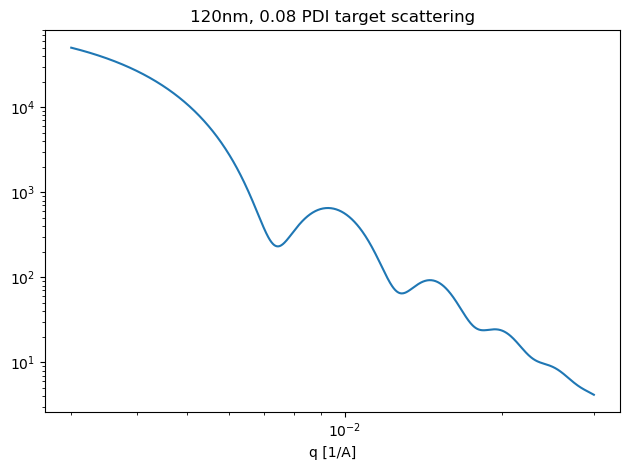

In [10]:
fig, ax = plt.subplots()
ax.loglog(10**q_grid, 10**target_I)
ax.set_xlabel('q [1/A]')
ax.set_title('120nm, 0.08 PDI target scattering')
plt.tight_layout()
plt.savefig('target_profile_120nm.png', dpi = 300)

21d4f4ac-db02-41f9-b1ad-00c2e61fc894


/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/subtract.py:124: UserWarning: No hiq lim satisfying threshold found, setting value to q max
  warnings.warn("No hiq lim satisfying threshold found, setting value to q max")


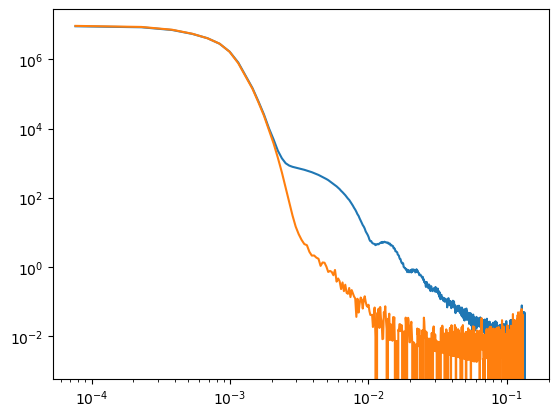

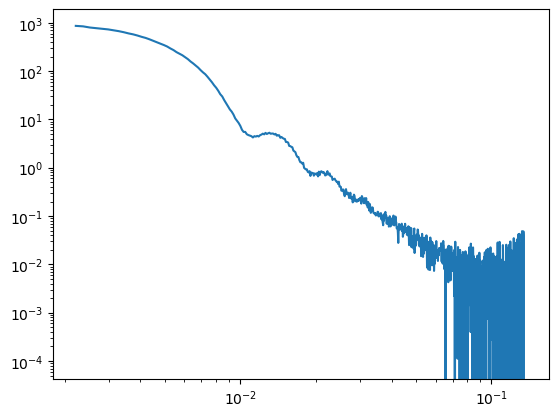

In [11]:
uuid_val = '21d4f4ac-db02-41f9-b1ad-00c2e61fc894'
entry = sample_data[uuid_val]

print(uuid_val)
bkg = uuid2bkg[uuid_val]

ratio_run = manipulate.ratio_running_average(entry[0]['I'], bkg[0]['I'])

subtracted = subtract.chop_subtract(entry[0], bkg[0], hiq_thresh=1)

fig, ax = plt.subplots()
ax.loglog(entry[0]['q'], entry[0]['I'])
ax.loglog(bkg[0]['q'], bkg[0]['I'])

fig, ax = plt.subplots()
if subtracted is not None:
    ax.loglog(subtracted['q'], subtracted['I'])
else:
    ax.text(1,1, 'failed')

## Run full processing pipeline

In [12]:
processing_dataset = {}
counter = 0
for uuid_val, data_val in sample_data.items():
    print(f'{counter}: {uuid_val}')
    counter += 1
    meas_entry = {}
    meas_entry['original_data'] = data_val[0]
    background = uuid2bkg[uuid_val]
    meas_entry['background'] = background[0]
    # 1. Subtract background and select q range
    subtracted = subtract.chop_subtract(data_val[0], background[0], hiq_thresh=1)
    
    if subtracted is None:
        # if subtract returned None, data has issues and we are done with this sample
        meas_entry['status'] = 'failed'
        meas_entry['failure_point'] = 'background_subtraction'
        processing_dataset[uuid_val] = meas_entry
        print(f'Sample {uuid_val} failed at background subtraction')
        continue
        
    else:
        # q range selection
        subtracted = subtracted[subtracted['q'] < q_max_subtract]
        subtracted = subtracted[~subtracted['I'].isna()]
        subtracted = subtracted[subtracted['I'] > 0] # drop negative values 
        # screen on dataset length
        if len(subtracted) < min_data_len:
            meas_entry['status'] = 'failed'
            meas_entry['failure_point'] = 'subtracted_data_length'
            processing_dataset[uuid_val] = meas_entry
            print(f'Sample {uuid_val} failed due to data length')
            continue
        else:
            meas_entry['subtracted_clipped'] = subtracted
            meas_entry['status'] = 'valid'
            processing_dataset[uuid_val] = meas_entry


    # 2. Convert everything into log10 space
    q_log = np.log10(subtracted['q'].to_numpy())
    I_log = np.log10(subtracted['I'].to_numpy())

    meas_entry['q_log'] = q_log
    meas_entry['I_log'] = I_log
    
    # 3. denoise filter on intensity
    
    I_savgol = manipulate.denoise_intensity(I_log, savgol_n = savgol_n, savgol_order = savgol_order)

    meas_entry['I_savgol'] = I_savgol

    # 4. Spline fit and interpolate
    I_spline = manipulate.fit_interpolate_spline(q_log, I_savgol, q_grid, s = s, k = k)
    
    meas_entry['I_spline'] = I_spline

    # 5. scale onto target
    I_scaled = manipulate.scale_intensity_highqavg(I_spline, target_I, n_avg = n_avg)

    meas_entry['I_scaled'] = I_scaled

    #6. Calculate AP distance

    amplitude, phase = target_comparison.ap_distance(q_grid, I_scaled, target_I, optim = optim, grid_dim = grid_dim)

    ap_sum = amplitude + phase

    meas_entry['amplitude_distance'] = amplitude
    meas_entry['phase_distance'] = phase
    meas_entry['ap_sum_distance'] = ap_sum

    processing_dataset[uuid_val] = meas_entry
    

0: 770a433d-0480-4cee-bf12-ce066c24db55
1: fed3ab35-04e9-4916-8527-8627191a3bdc
2: 4ab46dcc-3395-4e7b-bb87-52e805e12abb
3: 23850c30-c572-41ad-abf0-7e1bd4fa7397
4: 96ef6012-d812-4975-8b77-8ed7e78669fb
5: d03dab18-5712-44f7-9334-14047212632e
Sample d03dab18-5712-44f7-9334-14047212632e failed due to data length
6: a180d359-a229-4b3e-a615-2991fd549f42
7: ef17f542-90a3-44a8-a6b8-acb920953fab
8: e0368e49-ecc3-4ebf-9a19-4e942c829517
9: 4d5fd07b-987b-49df-b4ba-54d2a337d945
Sample 4d5fd07b-987b-49df-b4ba-54d2a337d945 failed due to data length
10: 6b50a94f-b7f2-402e-a210-e89f507b8861
1.0032446657458967
0.38497799799584187
78
11: 657e707f-abc9-4f86-ae1e-9e59efb6e1f9
Sample 657e707f-abc9-4f86-ae1e-9e59efb6e1f9 failed due to data length
12: 0e6edb88-77c3-4984-a38d-198341bba9e1
13: 32ec16b1-c5b5-4d8b-b396-cd1ad4b740d9
14: a4d8a8f6-2654-490f-b14a-02d3fb1f94b2
15: 3584700a-8b01-4e59-a53a-1300fd3fac0a
16: fa1dfc55-e5e0-4514-a66a-e29a5351518a
1.249238472215957
0.5377320753723704
39
17: 68831f53-4a51-4f1

/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/subtract.py:137: UserWarning: Insufficient data points in q range with scattering. Check data quality
  warnings.warn(


118: 8209442c-5fed-4dc0-ad42-c083465e58eb
119: 50d45172-6479-4d31-9ef6-bea791278606
120: bfcf29cb-db74-40a1-9d27-911985c3f28f
Sample bfcf29cb-db74-40a1-9d27-911985c3f28f failed due to data length
121: a3e0413e-4e1b-4f07-930b-690692b49c03
0.5262026156280357
0.4860727031869567
176
122: 82d46018-8a24-4bb2-92b6-b4626d334344
1.0014657090951902
0.9391404972147158
59
123: 56faa977-e163-444a-9156-e2fa4f7fe338
-1.3190094923260118
-1.4589876094211789
668
124: a20c37f0-5b38-4a7c-bee3-d0d3d116c9e0
Sample a20c37f0-5b38-4a7c-bee3-d0d3d116c9e0 failed due to data length
125: 81c548b0-7ef9-4ff0-b4e6-8977a3bb8ae4
1.0640383240543383
1.0221247429582885
59
126: 12720234-74cc-4a1a-9cdc-cad646138159
Sample 12720234-74cc-4a1a-9cdc-cad646138159 failed due to data length
127: 6791de91-caa6-4665-b50a-a0fcbadffcab
0.6796684835172229
0.6642221053893432
130
128: 74579cb8-62f3-4d9e-8f66-6ca76a8ff53a
0.91126300611315
0.897664962750313
78
129: 8d373b7d-c3a9-4148-8bcd-46021e36cb01
1.310131342344655
1.2838319888868361
1

### Sanity check subtraction

770a433d-0480-4cee-bf12-ce066c24db55
fed3ab35-04e9-4916-8527-8627191a3bdc
4ab46dcc-3395-4e7b-bb87-52e805e12abb
23850c30-c572-41ad-abf0-7e1bd4fa7397
96ef6012-d812-4975-8b77-8ed7e78669fb
d03dab18-5712-44f7-9334-14047212632e
failed at  subtracted_data_length
a180d359-a229-4b3e-a615-2991fd549f42
ef17f542-90a3-44a8-a6b8-acb920953fab
e0368e49-ecc3-4ebf-9a19-4e942c829517
4d5fd07b-987b-49df-b4ba-54d2a337d945
failed at  subtracted_data_length
6b50a94f-b7f2-402e-a210-e89f507b8861
657e707f-abc9-4f86-ae1e-9e59efb6e1f9
failed at  subtracted_data_length
0e6edb88-77c3-4984-a38d-198341bba9e1
32ec16b1-c5b5-4d8b-b396-cd1ad4b740d9
a4d8a8f6-2654-490f-b14a-02d3fb1f94b2
3584700a-8b01-4e59-a53a-1300fd3fac0a
fa1dfc55-e5e0-4514-a66a-e29a5351518a
68831f53-4a51-4f12-b385-10c50c8fab46
4bec4e18-80bb-44d9-8508-cc464f14b287
41414be7-3e27-4b4d-b70e-e31d54a733d3
81f8f6c2-0e42-4680-bc11-c0be02bfd641
47d95862-b511-4a42-b8b1-961b605f26a3
6abcfcc8-cf8d-4a5e-a92f-f3afd8023fbd
89b8593e-8436-4dfb-8430-1367d273cbc2
8559907a-1

/tmp/ipykernel_96970/1424264336.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


c2755e87-75e2-48c6-b27a-739971d1775c
fedab157-3d87-4f8b-b09b-590c966aa0ba
f59733f7-c03c-4712-934e-fb6ea464b604
ecc20fb9-daca-4f65-97ce-f1329696f7ec
3ae01d8c-6757-4aa4-8701-a4f231f6a81c
48c60f84-a45b-4017-9430-12b3234fdc0e
2a0a2e87-67a7-401a-943d-423159a4a939
43cd6089-f940-463f-bd40-a1f2bf168f67
9b9c349b-8f9d-4f0c-829c-fa99e67e90fb
ff3ac045-3c39-4fb0-b2c9-bf69d7600548
failed at  subtracted_data_length
5452fa4a-b64c-46d7-ace2-bf1b31afc3b3
failed at  subtracted_data_length
9aed2e5c-7127-46bd-8331-51407d127d8f
5edc0763-1f2c-44f2-bf68-db785ae258b0
320cdd85-691d-48fb-9eac-d27b2fc5e5f5
bf04b495-3291-4508-a497-e6d96dc52362
649ddf37-37fe-4a30-896b-010286133a28
failed at  subtracted_data_length
5175dc78-a900-486e-8b14-6b0441555fe2
2a988138-57f5-40bf-851c-3df09f642f05
9694a191-11f7-482c-bb4c-e119489126a4
a9d67fc5-2e59-4f51-a904-9cac957c9e73
2027f32f-4921-4edd-95bb-849ab8220e8c
f5458994-6b3e-4176-9427-7cef2bb6c7d5
5d67ff81-9548-4a2f-9496-5d3c3c25b3eb
f4b66637-2c73-4d0b-83ba-3f7e3b3f3c06
56898b1b-5

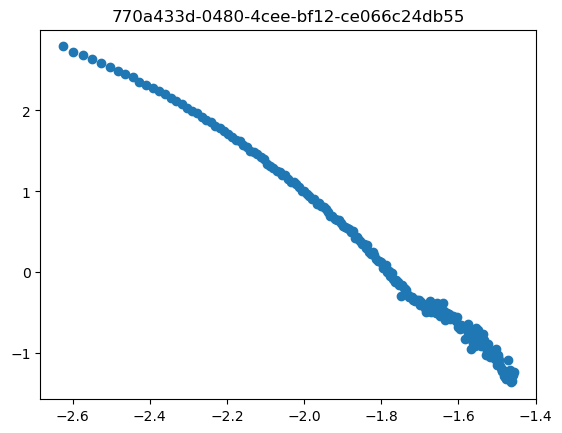

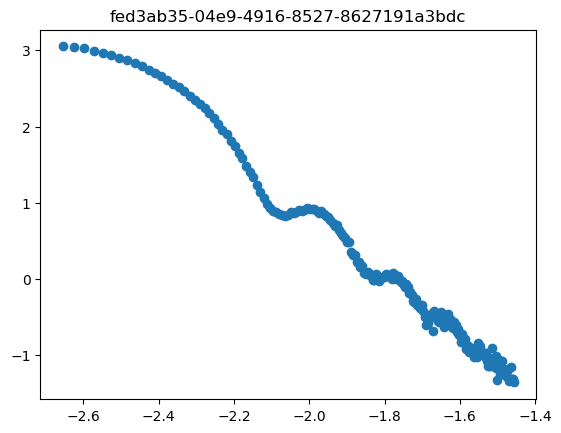

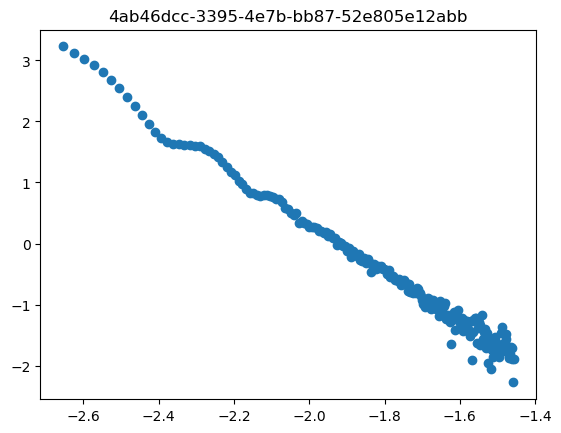

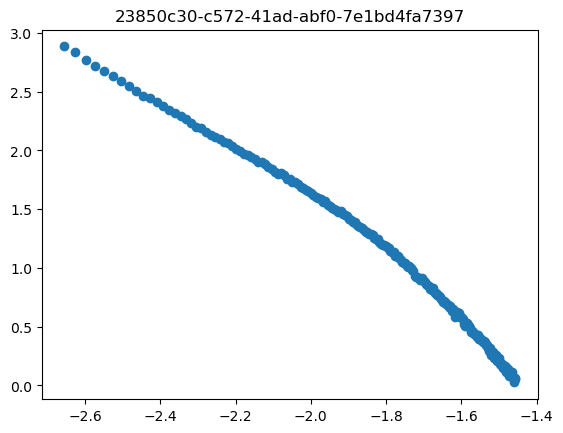

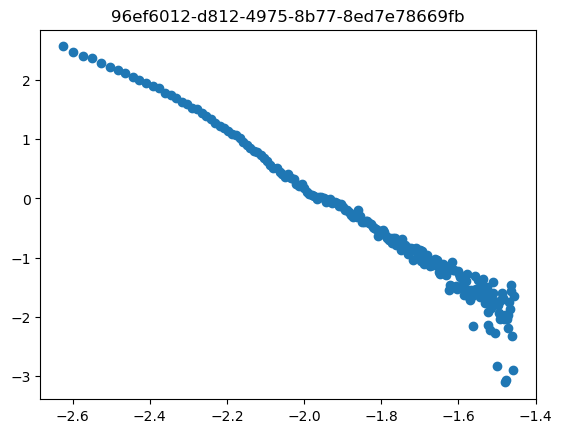

...

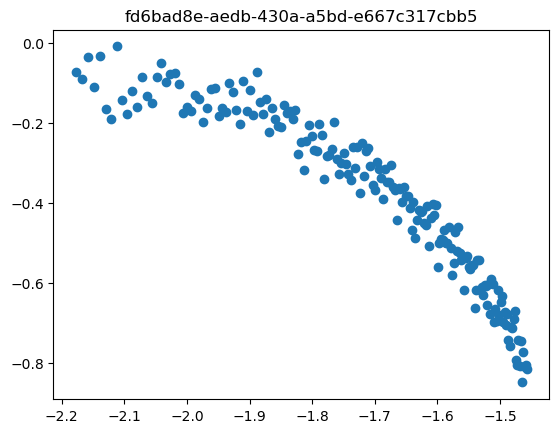

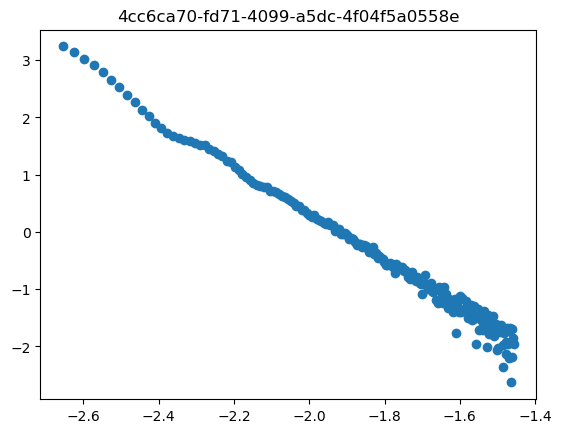

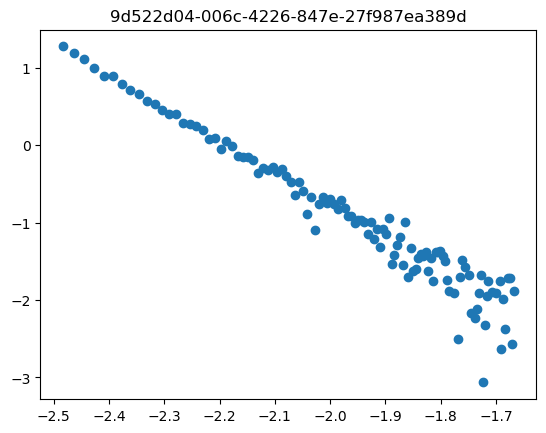

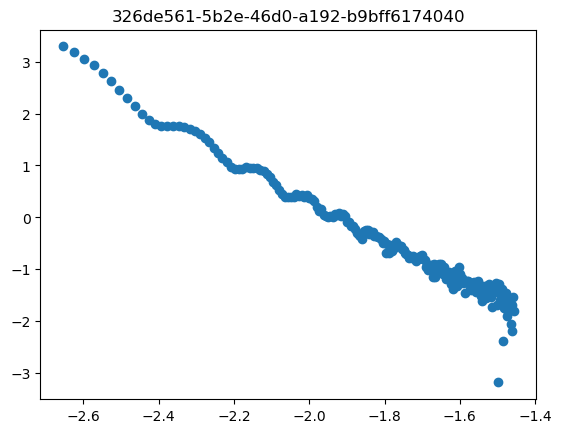

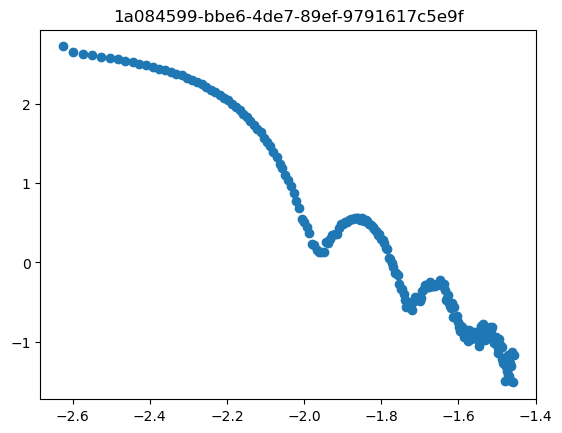

In [13]:
for uuid_val, entry in processing_dataset.items():
    print(uuid_val)
    try:
        status = entry['status']
        if status == 'failed':
            print('failed at ', entry['failure_point'])
            continue
        else:
            raise KeyError
    except KeyError:
        fig, ax = plt.subplots()
    
        I_subtracted = entry['I_log']
        q = entry['q_log']
    
        ax.scatter(q, I_subtracted)
        ax.set_title(uuid_val)

## Sanity check spline fit

/tmp/ipykernel_96970/3859189070.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


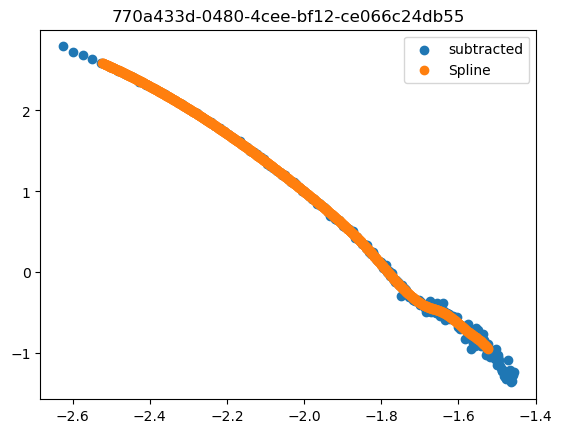

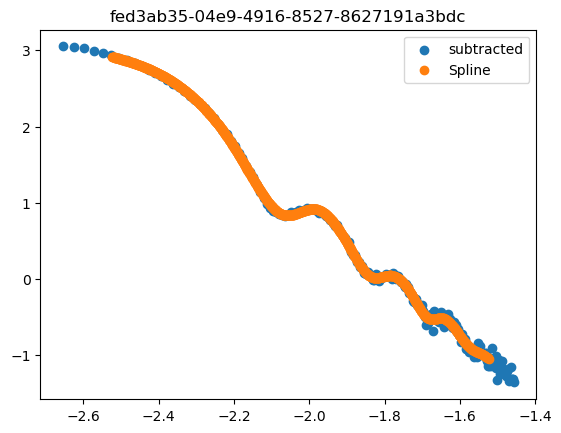

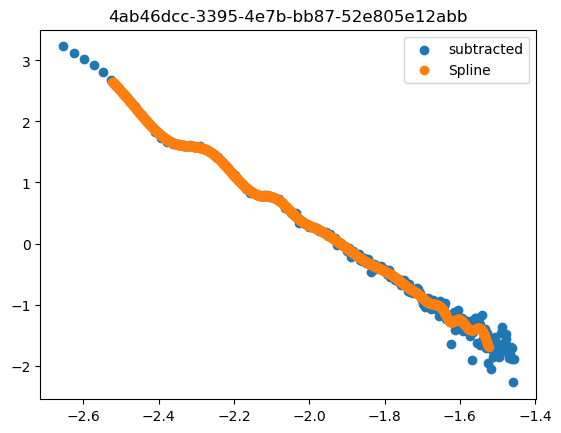

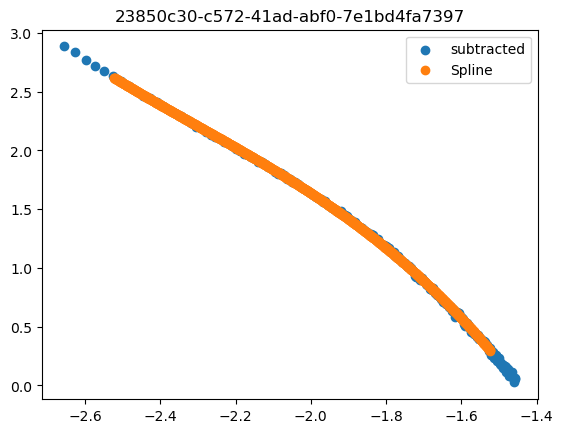

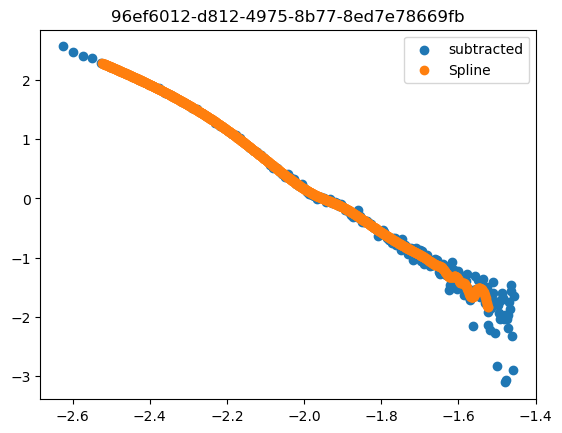

...

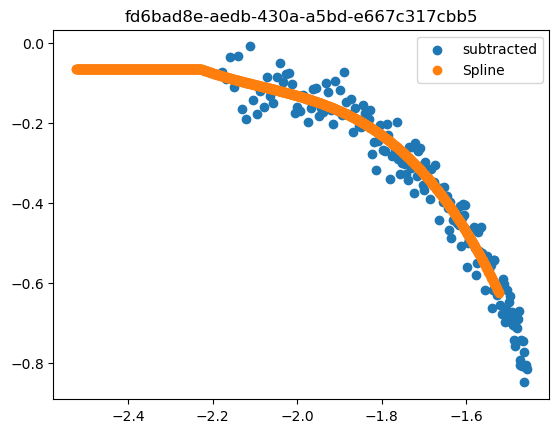

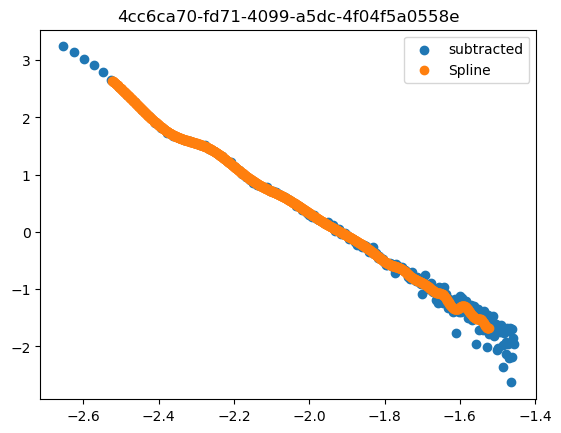

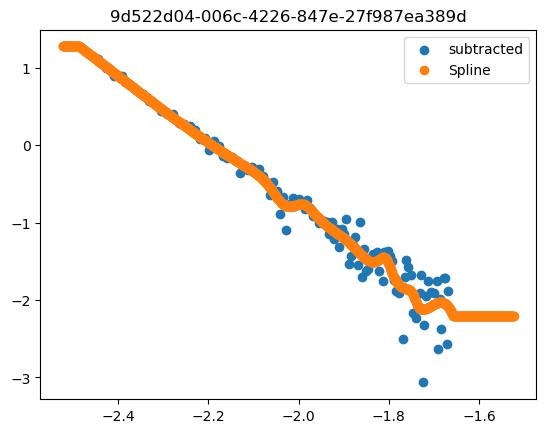

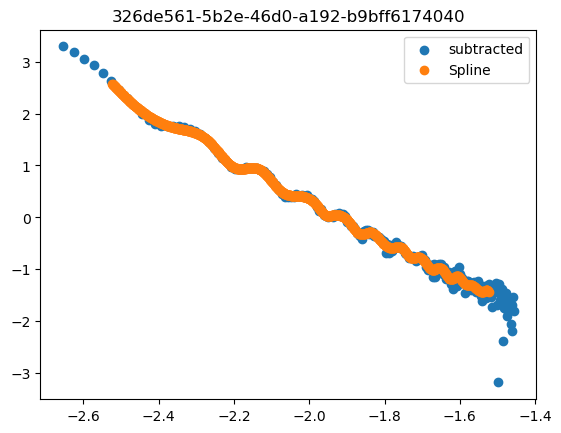

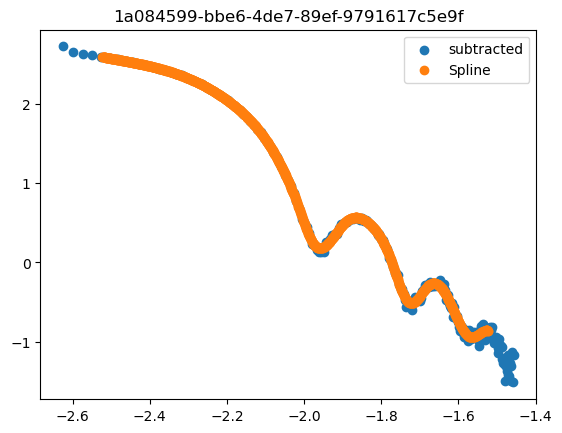

In [14]:
for uuid_val, entry in processing_dataset.items():
    try:
        status = entry['status']
        if status == 'failed':
            continue
        else:
            raise KeyError
    except KeyError:
        fig, ax = plt.subplots()
    
        I_subtracted = entry['I_log']
        q = entry['q_log']

        I_spline = entry['I_spline']
        
    
        ax.scatter(q, I_subtracted, label = 'subtracted')
        ax.scatter(q_grid, I_spline, label = 'Spline')
        ax.legend()
        ax.set_title(uuid_val)

## Sanity check scaling

/tmp/ipykernel_96970/1900914898.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


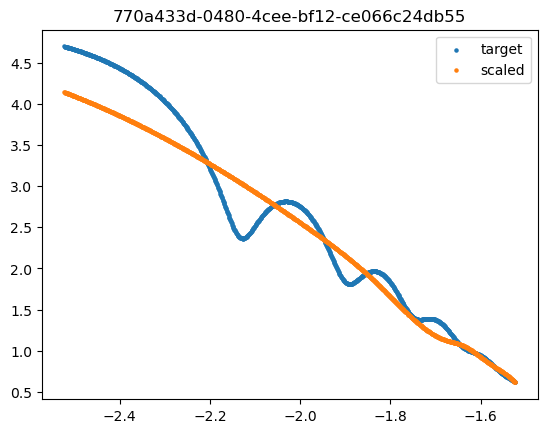

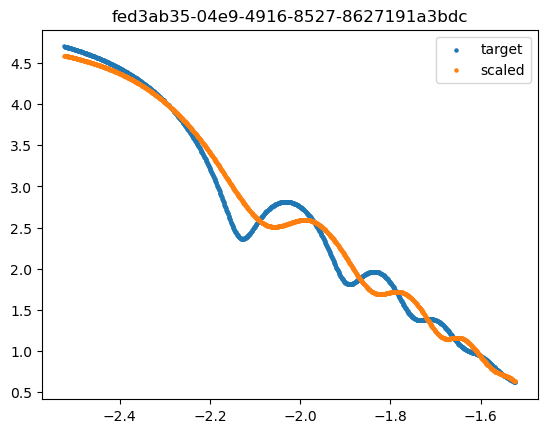

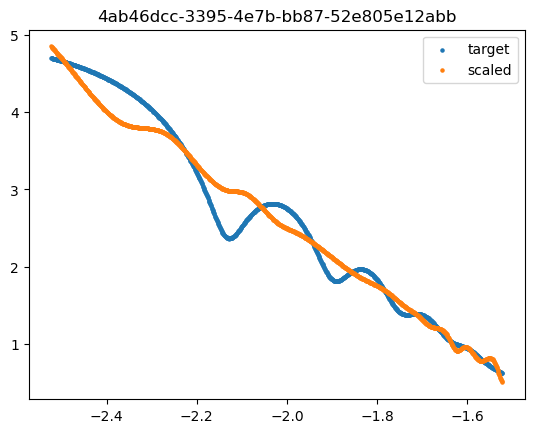

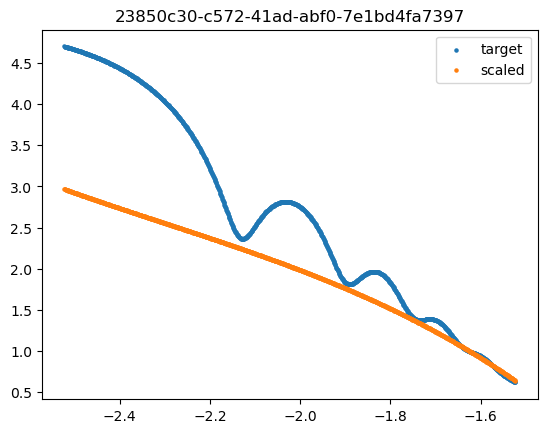

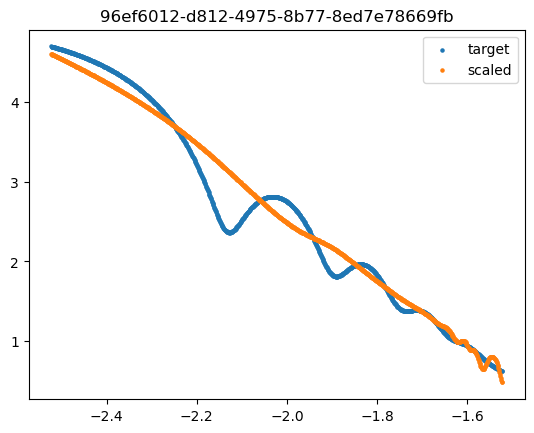

...

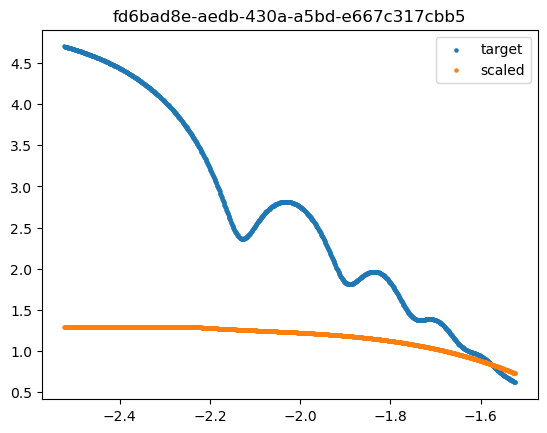

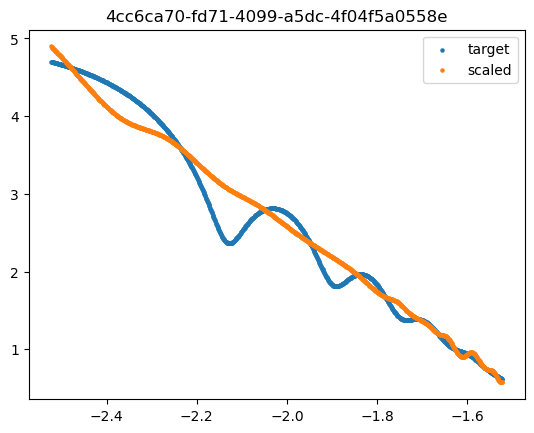

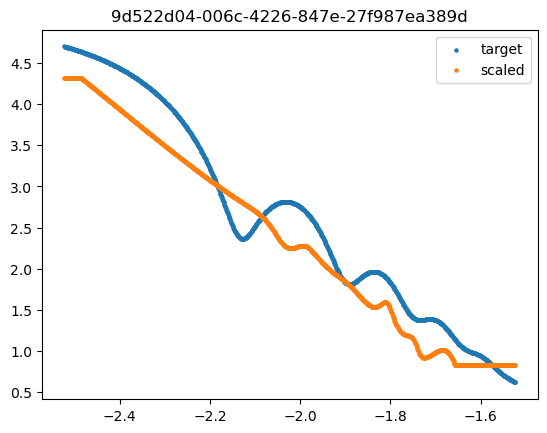

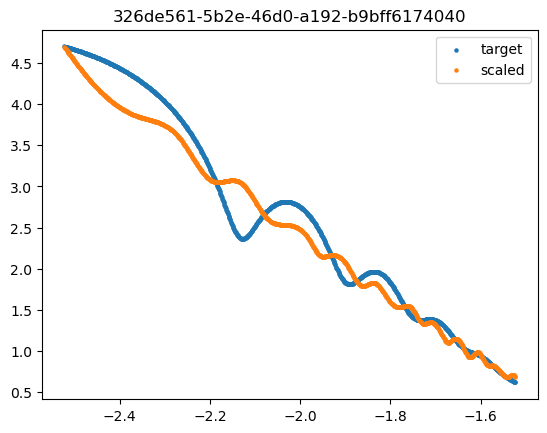

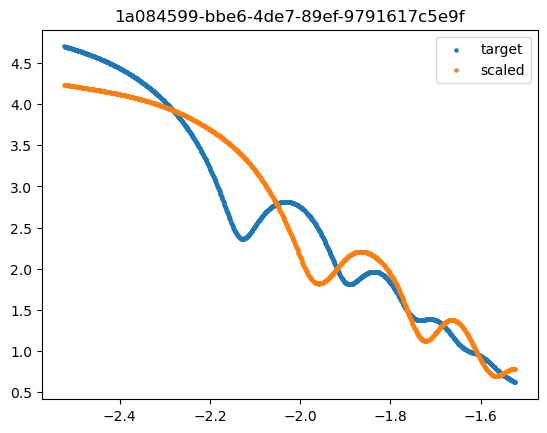

In [15]:
for uuid_val, entry in processing_dataset.items():
    try:
        status = entry['status']
        if status == 'failed':
            continue
        else:
            raise KeyError
    except KeyError:
        fig, ax = plt.subplots()


        I_scaled = entry['I_scaled']
        
    
        ax.scatter(q_grid, target_I, label = 'target', s = 5)
        ax.scatter(q_grid, I_scaled, label = 'scaled', s = 5)
        ax.legend()
        ax.set_title(uuid_val)

## Fit sphere model

In [29]:
for uuid_val, entry in processing_dataset.items():
    try:
        subtracted = entry['subtracted_clipped']
    except KeyError:
        continue
        
    data_sas = io.df_to_sasdata(subtracted)
    results, result_obj, problem  = sasview_fitting.fit_sphere(data_sas, polydispersity=True)

    processing_dataset[uuid_val]['sphere_fit_results'] = results
    processing_dataset[uuid_val]['sphere_fit_problem'] = problem

## sanity check fit results

/tmp/ipykernel_96970/3968789754.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


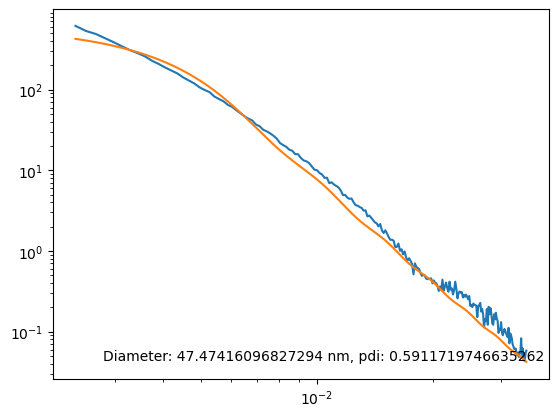

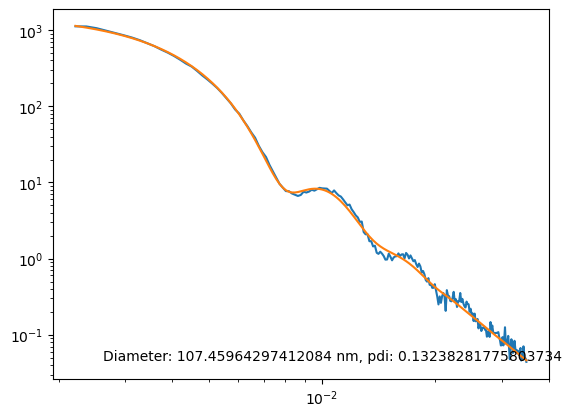

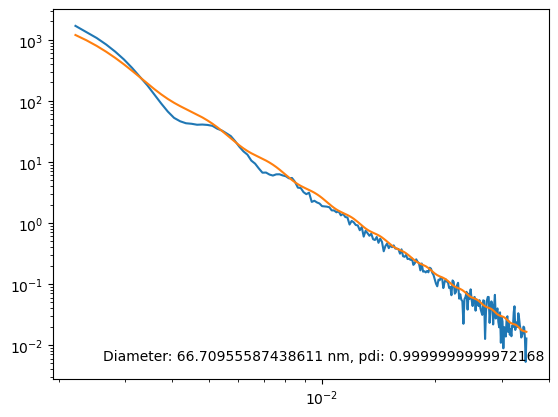

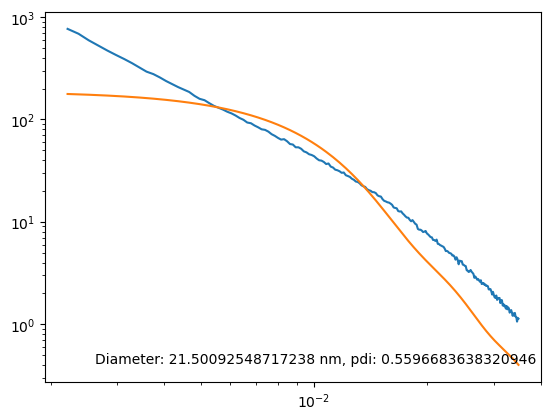

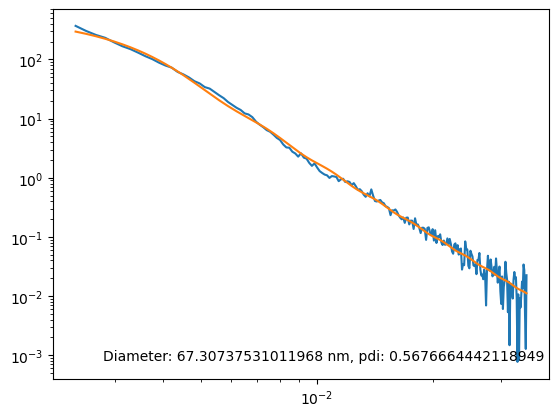

...

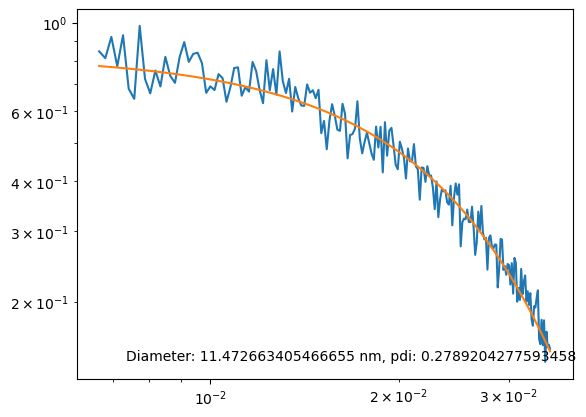

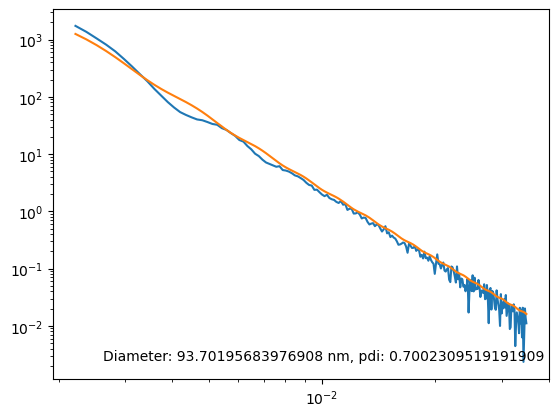

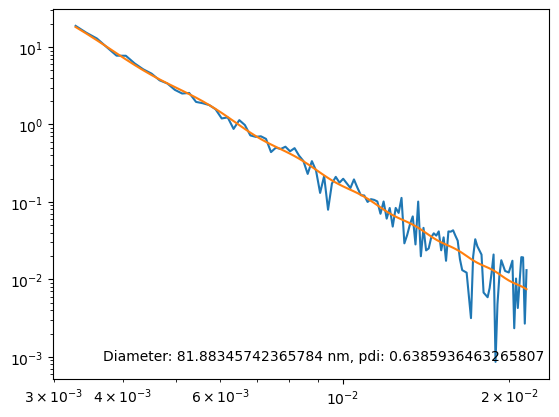

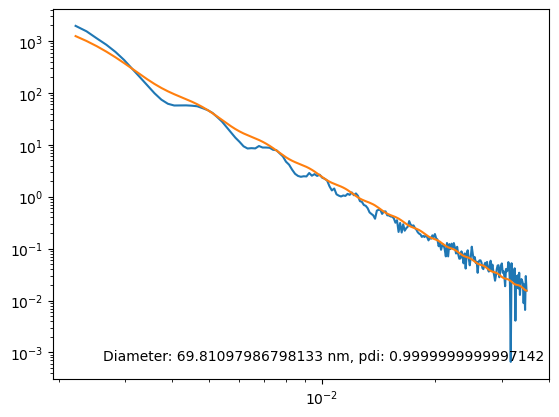

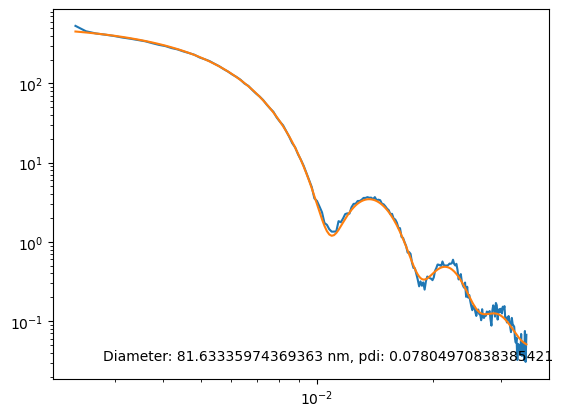

In [30]:
for uuid_val, entry in processing_dataset.items():
    try:
        sphere_d = entry['sphere_fit_results']['radius']*2/10
        sphere_pdi = entry['sphere_fit_results']['radius_pd']
    
        problem = entry['sphere_fit_problem']
    except KeyError:
        continue

    for model in problem.models:
        data = model._data
        Icalc = model.Iq_calc

    fig, ax = plt.subplots()

    ax.loglog(data.x, data.y, label = 'measured')
    ax.loglog(data.x, Icalc, label = 'fit')
    ax.text(0.1, 0.05, f'Diameter: {sphere_d} nm, pdi: {sphere_pdi}', transform = ax.transAxes)

## Plot final ranked order of best samples

In [31]:
sum_ap = {}
for uuid_val, entry in processing_dataset.items():
    try:
        status = entry['status']
        if status == 'failed':
            continue
        else:
            raise KeyError
            
    except KeyError:
        sum_ap[uuid_val] = entry['ap_sum_distance']


uuids = np.array(list(sum_ap.keys()))
rmses = list(sum_ap.values())
uuid_sorted_sum = uuids[np.argsort(rmses)]

In [38]:

with PdfPages('ranked_apdist_results.pdf') as pdf:
    for i, uuid_val in enumerate(uuid_sorted_sum):

        entry  = processing_dataset[uuid_val]
        I_scaled = entry['I_scaled']
        
        distance = sum_ap[uuid_val]

        sphere_d = entry['sphere_fit_results']['radius']*2/10
        sphere_pdi = entry['sphere_fit_results']['radius_pd']


    
        fig, ax = plt.subplots()
        ax.loglog(10**q_grid, 10**target_I, label = 'target')
        ax.loglog(10**q_grid, 10**I_scaled, label = 'measured')
        ax.set_xlabel('q [1/A]')
        ax.set_title(uuid_val)
        ax.text(0.1, 0.1, f'Rank: {i}\nsum distance: {distance:.2f}\nsphere diameter: {sphere_d:.2f} nm\nsphere pdi: {sphere_pdi:.2f}', transform = ax.transAxes)
        ax.legend()
        pdf.savefig()
        plt.close()

## Write results to disk

In [39]:
uuid_vals = []
amplitude = []
phase = []
sum_ap = []
statuses = []
sphere_diameter = []
sphere_pdi = []

for uuid_val, entry in processing_dataset.items():
    try:
        status = entry['status']
        if status == 'failed':
            uuid_vals.append(uuid_val)
            amplitude.append(None)
            phase.append(None)
            sum_ap.append(None)
            statuses.append('failed')
            sphere_diameter.append(None)
            sphere_pdi.append(None)
            continue
        else:
            raise KeyError
    except KeyError:
        uuid_vals.append(uuid_val)
        amplitude.append(entry['amplitude_distance'])
        phase.append(entry['phase_distance'])
        sum_ap.append(entry['ap_sum_distance'])
        statuses.append('success')
        sphere_diameter.append(entry['sphere_fit_results']['radius']*2/10)
        sphere_pdi.append(entry['sphere_fit_results']['radius_pd'])
    

In [40]:
results_df = pd.DataFrame({'uuid':uuid_vals, 'amplitude_distance':amplitude, 'phase_distance':phase, 'sum_ap_distance':sum_ap, 'sphere_diameter_nm':sphere_diameter, 'sphere_pdi':sphere_pdi, 'processes_status':statuses})

In [41]:
new_results_df = pd.concat([previous_result_df, results_df])

In [42]:
results_df.to_csv('amplitude_phase_results_afterOptimRound3_11_18_24.csv')

In [43]:
results_df

,uuid,amplitude_distance,phase_distance,sum_ap_distance,sphere_diameter_nm,sphere_pdi,processes_status
0,770a433d-0480-4cee-bf12-ce066c24db55,1.079610,0.407451,1.487061,47.474161,0.591172,success
1,fed3ab35-04e9-4916-8527-8627191a3bdc,0.474113,0.177540,0.651653,107.459643,0.132383,success
2,4ab46dcc-3395-4e7b-bb87-52e805e12abb,0.979413,0.540022,1.519435,66.709556,1.000000,success
3,23850c30-c572-41ad-abf0-7e1bd4fa7397,1.176489,0.445089,1.621578,21.500925,0.559668,success
4,96ef6012-d812-4975-8b77-8ed7e78669fb,1.003274,0.520217,1.523491,67.307375,0.567666,success
...,...,...,...,...,...,...,...
175,fd6bad8e-aedb-430a-a5bd-e667c317cbb5,1.715798,0.575287,2.291085,11.472663,0.278920,success
176,4cc6ca70-fd71-4099-a5dc-4f04f5a0558e,1.032662,0.516989,1.549651,93.701957,0.700231,success
177,9d522d04-006c-4226-847e-27f987ea389d,0.770329,0.492434,1.262763,81.883457,0.638594,success
178,326de561-5b2e-46d0-a192-b9bff6174040,0.921530,0.471859,1.393389,69.810980,1.000000,success
